# Compare BUSCO-based and LIN-based phylogenies

In [1]:
## Import dependencies

import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

## Load the BUSCO based tree

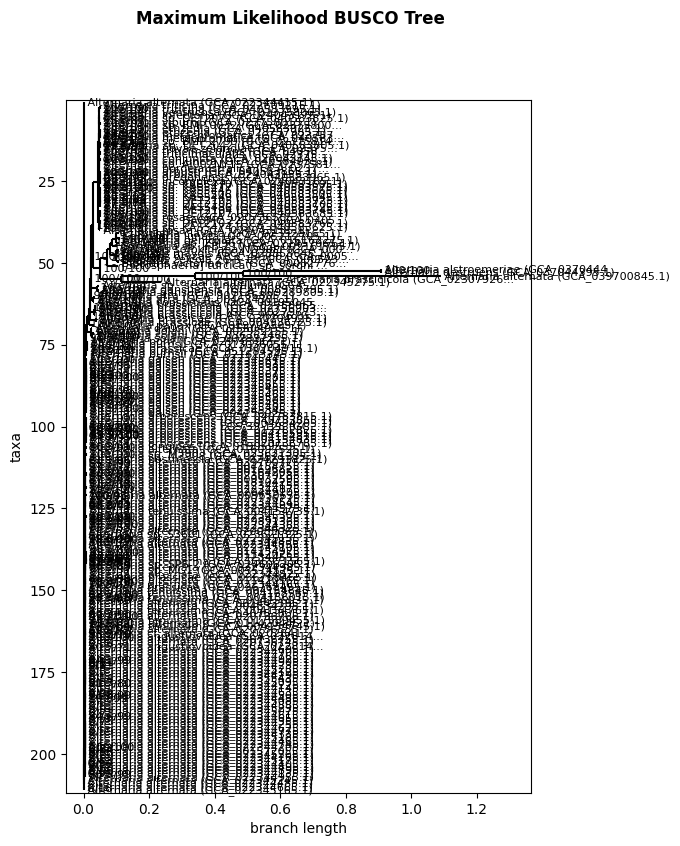

In [2]:
from Bio import Phylo
import pickle

os.chdir('/nfs4/BPP/Uehling_Lab/johnsh/FungalLINs/ForGeneTrees/IntermediateFiles/Alternaria_IF')

# Load dictionary from a file
with open('AlternariaDictionary.pkl', 'rb') as file:
    AlternariaDictionary = pickle.load(file)

# Load the IQ-TREE output file 
BUSCOtree = Phylo.read("AlternariaBUSCOsTrimmed.faa.treefile", "newick")


# Update the leaf labels in the tree
for leaf in BUSCOtree.get_terminals():
    if leaf.name in AlternariaDictionary:
        leaf.name = AlternariaDictionary[leaf.name]


# Plot the updated tree
fig = plt.figure(figsize=(6, 9))
ax = fig.add_subplot(1, 1, 1)
# Draw the tree without showing it yet
Phylo.draw(BUSCOtree, axes=ax, do_show=False)

# Adjust font sizes for all labels
for text in ax.texts:
    text.set_fontsize(8) 

# Add a title
fig.suptitle("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')

plt.show()

In [3]:
from io import StringIO

# Create a StringIO object to hold the Newick format as a string
newick_str = StringIO()
Phylo.write(BUSCOtree, newick_str, "newick")

# Get the Newick string from the StringIO object
BUSCO_newick = newick_str.getvalue()

# Close the StringIO object
newick_str.close()

# Now the Newick string is stored in the `newick_variable` variable
print(BUSCO_newick)

('Alternaria alternata (GCA_022344415.1)':0.00000,((((((((((((((((((((((((((((((((('Alternaria triticina (GCA_022609215.1)':0.00000,'Alternaria triticina (GCA_040583995.1)':0.00000)100/100:0.00203,'Alternaria ventricosa (GCA_023758065.1)':0.00227)100/100:0.00153,(((((('Alternaria infectoria (GCA_024043175.1)':0.00251,'Alternaria sp. DET2072 (GCA_040583825.1)':0.00276)78.8/86:0.00019,('Alternaria viburni (GCA_023758015.1)':0.00231,'Alternaria sp. BMP 0032 (GCA_023758005.1)':0.00210)100/100:0.00062)95.8/87:0.00026,(((('Alternaria ethzedia (GCA_040583925.1)':0.00000,'Alternaria ethzedia (GCA_023757985.1)':0.00000)100/100:0.00262,('Alternaria metachromatica (GCA_023757995.1)':0.00000,'Alternaria metachromatica (GCA_040583895.1)':0.00023)100/100:0.00248)99/82:0.00031,(('Alternaria sp. BMP 2799 (GCA_023758145.1)':0.00222,'Alternaria sp. DET2042 (GCA_040583805.1)':0.00275)94.3/94:0.00029,'Alternaria novae-zelandiae (GCA_023758075.1)':0.00272)99.6/91:0.00022)99/84:0.00025,('Alternaria triticim

In [4]:
AlternariaDictionary

{'GCA_022344415.1': 'Alternaria alternata (GCA_022344415.1)',
 'GCA_022609215.1': 'Alternaria triticina (GCA_022609215.1)',
 'GCA_024043175.1': 'Alternaria infectoria (GCA_024043175.1)',
 'GCA_001642055.1': 'Alternaria alternata (GCA_001642055.1)',
 'GCA_022344765.1': 'Alternaria alternata (GCA_022344765.1)',
 'GCA_022345445.1': 'Alternaria gaisen (GCA_022345445.1)',
 'GCA_040583925.1': 'Alternaria ethzedia (GCA_040583925.1)',
 'GCA_023758145.1': 'Alternaria sp. BMP 2799 (GCA_023758145.1)',
 'GCA_017589455.1': 'Alternaria tenuissima (GCA_017589455.1)',
 'GCA_020736745.1': 'Alternaria alternata (GCA_020736745.1)',
 'GCA_022345075.1': 'Alternaria alternata (GCA_022345075.1)',
 'GCA_030704925.1': 'Alternaria brassicae (GCA_030704925.1)',
 'GCA_022344355.1': 'Alternaria alternata (GCA_022344355.1)',
 'GCA_040583915.1': 'Alternaria triticimaculans (GCA_040583915.1)',
 'GCA_023920165.1': 'Curvularia clavata (GCA_023920165.1)',
 'GCA_024291825.1': 'Alternaria postmessia (GCA_024291825.1)',
 '

## Load LIN info and build trees

In [5]:
pip install openpyxl

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [6]:
## Create dataframe of all LINs of appropriate taxa which met over 80% BUSCO completeness criterion

# Switch to directory containting files of interest
os.chdir('/nfs4/BPP/Uehling_Lab/johnsh/FungalLINs/LINsFromKassaye/SecondLIN_Set')

# Open appropriate files using pandas
FungalLINs = pd.read_excel('fungi_LINs_merged_TaxID_LINEAGE_08152024.xlsx')

# Create columns for accessions (need to extract accessions from .fna file names)
FungalLINs['Accession'] = FungalLINs['filePath'].apply(lambda x: "_".join(x.split("_")[0:2])) # Wasn't necessary, already had an accession column for this one

# Extract only assemblies in dictionary containing assemblies with over 80% BUSCO completeness
AlternariaList = list(AlternariaDictionary.keys())
AlternariaLINs_df = FungalLINs[FungalLINs['Accession'].isin(AlternariaList)]

In [7]:
AlternariaLINs_df

,genomeID,LIN,Domain,Kingdom,Phylum,Class,Order,Family,organismName,taxID,...,filterID,rankScore,measure1,measure2,measure3,measure4,measureN,validation,accession,Accession
1406,15460,"6,2,0,0,1,0,1,0,0,0,0,4,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Alternaria alstroemeriae,1111114,...,10.0,99.9995,0.999774,0.999995,0.0,0.999887,[0.999915273384546],True,GCA_037044435.1,GCA_037044435.1
1407,15283,"27,2,0,1,0,0,0,0,1,0,4,7,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Alternaria alternarina,1281297,...,10.0,99.1713,0.723638,0.991713,0.0,0.839663,[0.8397270659590599],True,GCA_036971565.1,GCA_036971565.1
1408,1200,"27,2,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Alternaria alternata,5599,...,10.0,97.3551,0.398110,0.973551,0.0,0.569609,[0.5775561402435293],True,GCA_001443195.1,GCA_001443195.1
1409,1279,"27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Alternaria alternata,5599,...,10.0,98.7555,0.624245,0.987555,0.0,0.768844,[0.7807930000611882],True,GCA_001572055.1,GCA_001572055.1
1411,9164,"27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,10,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Alternaria alternata,5599,...,10.0,99.9760,0.989968,0.999760,0.0,0.994978,[0.9993651753325272],True,GCA_022344905.1,GCA_022344905.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1678,4343,"27,5,2,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Curvularia lunata,5503,...,10.0,100.0000,1.000000,1.000000,0.0,1.000000,[1.0],True,GCA_005212705.1,GCA_005212705.1
1681,2142,"27,5,2,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Curvularia sp. IFB-Z10,1526222,...,10.0,86.3097,0.023235,0.863097,0.0,0.045426,[0.046123468978496285],True,GCA_002161795.1,GCA_002161795.1
1682,9245,"27,5,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Curvularia sp. ZM96,2888491,...,10.0,90.0617,0.058763,0.900617,0.0,0.111004,[0.11132719004308282],True,GCA_022457065.1,GCA_022457065.1
1795,10845,"27,5,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0",Eukaryota,Fungi,Ascomycota,Dothideomycetes,Pleosporales,Pleosporaceae,Setosphaeria turcica f. sp. sorghi,1540003,...,10.0,99.7267,0.894203,0.997267,0.0,0.944151,[0.9459747015013596],True,GCA_024606495.1,GCA_024606495.1


In [8]:
# Make a dictionary with LINs rather than taxon name (accession #).

LIN_Dictionary = AlternariaLINs_df.set_index("Accession")["LIN"].to_dict()
LIN_Dictionary

{'GCA_037044435.1': '6,2,0,0,1,0,1,0,0,0,0,4,0,0,0,0,0,0,0,0',
 'GCA_036971565.1': '27,2,0,1,0,0,0,0,1,0,4,7,0,0,0,0,0,0,0,0',
 'GCA_001443195.1': '27,2,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0',
 'GCA_001572055.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0',
 'GCA_022344905.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,10,0',
 'GCA_022344925.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,11,0',
 'GCA_022345175.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,12,0',
 'GCA_022345235.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,13,0',
 'GCA_022355435.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,14,0',
 'GCA_022344145.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,2,0',
 'GCA_022344295.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,3,0',
 'GCA_022344335.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,3,1',
 'GCA_022344765.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,3,2',
 'GCA_022344435.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,4,0',
 'GCA_022344465.1': '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,5,0',
 'GCA_022344635.1': '27,2,0,1,0,0,0,

In [9]:
import matplotlib.colors as mcolors

import matplotlib.colors as mcolors

# Define the color palette
colors = list(mcolors.TABLEAU_COLORS.values())  # Use predefined colors
color_index = 0

# Create a dictionary for the LIN values (splitting the LIN string and using the first two values)
color_map = {}
LIN_color_dict = {}

for lin_str in LIN_Dictionary.values():
    # Extract the first two values from the LIN string
    first_two_values = tuple(lin_str.split(',')[:9])  # Get the first two LIN values
    if first_two_values not in color_map:
        # Assign a unique color if not already assigned
        color_map[first_two_values] = colors[color_index % len(colors)]
        color_index += 1

# Map the LIN values to the corresponding colors
for accession, lin_str in LIN_Dictionary.items():
    first_two_values = tuple(lin_str.split(',')[:9])  # Extract the first two values from the LIN string
    LIN_color_dict[lin_str] = color_map[first_two_values]  # Map to the corresponding color

# Print the final color dictionary
print("Final Color Dictionary:")
print(LIN_color_dict)

Final Color Dictionary:
{'6,2,0,0,1,0,1,0,0,0,0,4,0,0,0,0,0,0,0,0': '#1f77b4', '27,2,0,1,0,0,0,0,1,0,4,7,0,0,0,0,0,0,0,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,10,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,11,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,12,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,13,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,14,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,2,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,3,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,3,1': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,3,2': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,4,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,5,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,6,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,7,0': '#ff7f0e', '27,2,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,

In [10]:
# 
new_dict = {value: key for key, value in AlternariaDictionary.items()}
new_dict

{'Alternaria alternata (GCA_022344415.1)': 'GCA_022344415.1',
 'Alternaria triticina (GCA_022609215.1)': 'GCA_022609215.1',
 'Alternaria infectoria (GCA_024043175.1)': 'GCA_024043175.1',
 'Alternaria alternata (GCA_001642055.1)': 'GCA_001642055.1',
 'Alternaria alternata (GCA_022344765.1)': 'GCA_022344765.1',
 'Alternaria gaisen (GCA_022345445.1)': 'GCA_022345445.1',
 'Alternaria ethzedia (GCA_040583925.1)': 'GCA_040583925.1',
 'Alternaria sp. BMP 2799 (GCA_023758145.1)': 'GCA_023758145.1',
 'Alternaria tenuissima (GCA_017589455.1)': 'GCA_017589455.1',
 'Alternaria alternata (GCA_020736745.1)': 'GCA_020736745.1',
 'Alternaria alternata (GCA_022345075.1)': 'GCA_022345075.1',
 'Alternaria brassicae (GCA_030704925.1)': 'GCA_030704925.1',
 'Alternaria alternata (GCA_022344355.1)': 'GCA_022344355.1',
 'Alternaria triticimaculans (GCA_040583915.1)': 'GCA_040583915.1',
 'Curvularia clavata (GCA_023920165.1)': 'GCA_023920165.1',
 'Alternaria postmessia (GCA_024291825.1)': 'GCA_024291825.1',
 '

In [11]:
# Creating a new dictionary with accession numbers as keys and color values from LIN_color_dict
final_color_dict = {}

for accession, taxon in AlternariaDictionary.items():
    # Get the LIN string corresponding to the accession
    lin_str = LIN_Dictionary.get(accession)
    
    # If a LIN string is found, use the corresponding color from LIN_color_dict
    if lin_str:
        final_color_dict[accession] = LIN_color_dict.get(lin_str)

# Print the final dictionary
print("Final Color Dictionary with Accessions:")
print(final_color_dict)

Final Color Dictionary with Accessions:
{'GCA_022344415.1': '#ff7f0e', 'GCA_022609215.1': '#8c564b', 'GCA_024043175.1': '#1f77b4', 'GCA_001642055.1': '#ff7f0e', 'GCA_022344765.1': '#ff7f0e', 'GCA_022345445.1': '#e377c2', 'GCA_040583925.1': '#8c564b', 'GCA_023758145.1': '#17becf', 'GCA_017589455.1': '#ff7f0e', 'GCA_020736745.1': '#ff7f0e', 'GCA_022345075.1': '#ff7f0e', 'GCA_030704925.1': '#17becf', 'GCA_022344355.1': '#ff7f0e', 'GCA_040583915.1': '#9467bd', 'GCA_023920165.1': '#2ca02c', 'GCA_024291825.1': '#ff7f0e', 'GCA_022345305.1': '#ff7f0e', 'GCA_022344695.1': '#ff7f0e', 'GCA_023757995.1': '#ff7f0e', 'GCA_009650635.1': '#ff7f0e', 'GCA_907166805.1': '#7f7f7f', 'GCA_004936725.1': '#17becf', 'GCA_001572055.1': '#ff7f0e', 'GCA_040583865.1': '#e377c2', 'GCA_023621325.1': '#ff7f0e', 'GCA_004154845.1': '#ff7f0e', 'GCA_022345185.1': '#ff7f0e', 'GCA_040583805.1': '#1f77b4', 'GCA_022345635.1': '#e377c2', 'GCA_040783815.1': '#8c564b', 'GCA_022344665.1': '#ff7f0e', 'GCA_022344255.1': '#ff7f0e',

In [12]:
# Create a new dictionary with the taxon names from `new_dict` as keys and corresponding colors from `final_color_dict`
final_taxon_color_dict = {}

# Loop through each key-value pair in `new_dict`
for taxon, accession in new_dict.items():
    # Use the accession to get the color from `final_color_dict`
    color = final_color_dict.get(accession)
    
    # If a color is found, add it to the new dictionary
    if color:
        final_taxon_color_dict[taxon] = color

# Print the final taxon-color dictionary
print(final_taxon_color_dict)

{'Alternaria alternata (GCA_022344415.1)': '#ff7f0e', 'Alternaria triticina (GCA_022609215.1)': '#8c564b', 'Alternaria infectoria (GCA_024043175.1)': '#1f77b4', 'Alternaria alternata (GCA_001642055.1)': '#ff7f0e', 'Alternaria alternata (GCA_022344765.1)': '#ff7f0e', 'Alternaria gaisen (GCA_022345445.1)': '#e377c2', 'Alternaria ethzedia (GCA_040583925.1)': '#8c564b', 'Alternaria sp. BMP 2799 (GCA_023758145.1)': '#17becf', 'Alternaria tenuissima (GCA_017589455.1)': '#ff7f0e', 'Alternaria alternata (GCA_020736745.1)': '#ff7f0e', 'Alternaria alternata (GCA_022345075.1)': '#ff7f0e', 'Alternaria brassicae (GCA_030704925.1)': '#17becf', 'Alternaria alternata (GCA_022344355.1)': '#ff7f0e', 'Alternaria triticimaculans (GCA_040583915.1)': '#9467bd', 'Curvularia clavata (GCA_023920165.1)': '#2ca02c', 'Alternaria postmessia (GCA_024291825.1)': '#ff7f0e', 'Alternaria alternata (GCA_022345305.1)': '#ff7f0e', 'Alternaria alternata (GCA_022344695.1)': '#ff7f0e', 'Alternaria metachromatica (GCA_0237579

In [13]:
'''

### This is the first UPGMA attempt. I feel more comfortable with the built-in BioPython function

## First compute distance matrix, then plot UPGMA tree

# Load dependencies
from scipy.spatial.distance import squareform
from scipy.cluster.hierarchy import linkage, dendrogram

# Specify the dataframe containing the LINs for tree building
DfOfInterest = AlternariaLINs_df.copy()

# Convert the "LIN" column from comma-separated strings to lists of integers
DfOfInterest["LIN"] = DfOfInterest["LIN"].apply(lambda x: [int(value) for value in x.split(",")])

# Set some initial parameters
NumEntries = len(DfOfInterest["Accession"])     # Number of LINs under consideration
SimMatrix = np.zeros([NumEntries, NumEntries])     # Initialize a matrix for containing pairwise similarities
LIN_Scheme = np.array([50.0, 75.0, 80.0, 85.0, 90.0, 92.5, 95.0, 96.0, 97.0, 98.0, 98.5, 99.0, 99.25, 99.5, 99.75, 99.9, 99.925, 99.95, 99.975, 99.99, 99.999])/100
LINsOfInterest = DfOfInterest["LIN"]     # Define the series containing only the LINs for tree building

# Loop for iterating through all LINs and comparing to all other LINs, determining how many LIN positions from the leftside that each LIN is identical to other LINs
for i in np.arange(NumEntries):
    for ii in np.arange(NumEntries):
        if i == ii:     # Check if LIN is being compared to itself, and if so similarity is 1.0
            SimMatrix[i,ii] = 1
        else:     # If LIN is compared to non-self, continue to counting number of identical positions from the left
            count = 0     # Set counter of identical LIN spaces to zero for each pairwise comparison                                                
            for iii in np.arange(len(LIN_Scheme)-1):     # iterate through LIN positions until there is a mismatch between the LINs being compared (minus one because I added 50 arbitrarily for those that don't match at the first LIN position)
                if LINsOfInterest[i:i+1].values[0][iii] == LINsOfInterest[ii:ii+1].values[0][iii]:     # Compare successive positions for LINs being compared
                    count += 1
                else:
                    break
            SimMatrix[i,ii] = LIN_Scheme[count]

# Convert similarity matrix to a distance matrix
DistMatrix = 1 - SimMatrix

# Condense distance matrix
DistMatrix = squareform(DistMatrix)

# Compute linkage for UPGMA tree
Z = linkage(DistMatrix, method='average')  

# Create the list of labels (accessions) to be used in the dendrogram
labels = DfOfInterest["Accession"].values

# Create a mapping of old names (accessions) to new names using AlternariaDictionary
renamed_labels = [AlternariaDictionary.get(label, label) for label in labels]

# Plot the dendrogram with horizontal orientation and adjust label rotation
Tree = dendrogram(Z, labels=renamed_labels, orientation='left')

'''

'\n\n### This is the first UPGMA attempt. I feel more comfortable with the built-in BioPython function\n\n## First compute distance matrix, then plot UPGMA tree\n\n# Load dependencies\nfrom scipy.spatial.distance import squareform\nfrom scipy.cluster.hierarchy import linkage, dendrogram\n\n# Specify the dataframe containing the LINs for tree building\nDfOfInterest = AlternariaLINs_df.copy()\n\n# Convert the "LIN" column from comma-separated strings to lists of integers\nDfOfInterest["LIN"] = DfOfInterest["LIN"].apply(lambda x: [int(value) for value in x.split(",")])\n\n# Set some initial parameters\nNumEntries = len(DfOfInterest["Accession"])     # Number of LINs under consideration\nSimMatrix = np.zeros([NumEntries, NumEntries])     # Initialize a matrix for containing pairwise similarities\nLIN_Scheme = np.array([50.0, 75.0, 80.0, 85.0, 90.0, 92.5, 95.0, 96.0, 97.0, 98.0, 98.5, 99.0, 99.25, 99.5, 99.75, 99.9, 99.925, 99.95, 99.975, 99.99, 99.999])/100\nLINsOfInterest = DfOfInterest["

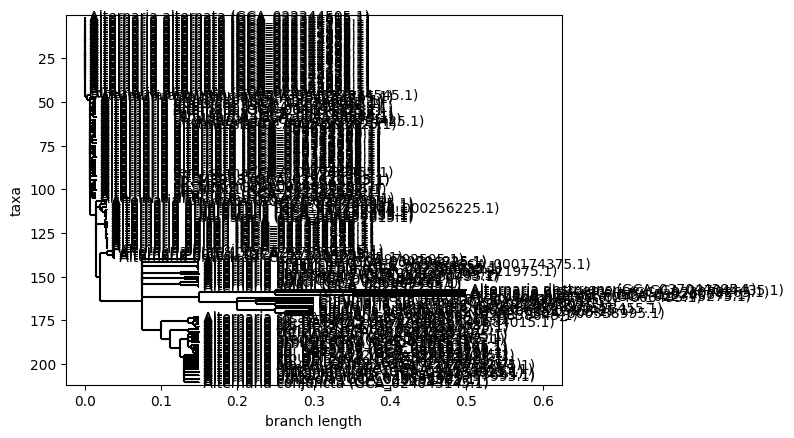

In [14]:
## Compute and display neighbor-joining LIN tree
## First compute distance matrix, then plot neighbor joining tree

# Load dependencies
from Bio.Phylo.TreeConstruction import DistanceTreeConstructor, _DistanceMatrix
from Bio.Phylo import draw
from scipy.spatial.distance import squareform

# Specify the dataframe containing the LINs for tree building
DfOfInterest = AlternariaLINs_df.copy()

# Convert the "LIN" column from comma-separated strings to lists of integers
DfOfInterest["LIN"] = DfOfInterest["LIN"].apply(lambda x: [int(value) for value in x.split(",")])

# Set some initial parameters
NumEntries = len(DfOfInterest["Accession"])  # Number of LINs under consideration
SimMatrix = np.zeros([NumEntries, NumEntries])  # Initialize a matrix for containing pairwise similarities
LIN_Scheme = np.array([50.0, 70.0, 80.0, 85.0, 90.0, 92.5, 95.0, 96.0, 97.0, 98.0, 98.5, 99.0, 99.25, 99.5, 99.75, 99.9, 99.925, 99.95, 99.975, 99.99, 99.999]) / 100
LINsOfInterest = DfOfInterest["LIN"]  # Define the series containing only the LINs for tree building

# Loop for iterating through all LINs and comparing to all other LINs, determining how many LIN positions from the leftside that each LIN is identical to other LINs
for i in np.arange(NumEntries):
    for ii in np.arange(NumEntries):
        if i == ii:  # Check if LIN is being compared to itself, and if so similarity is 1.0
            SimMatrix[i, ii] = 1
        else:  # If LIN is compared to non-self, continue to counting number of identical positions from the left
            count = 0  # Set counter of identical LIN spaces to zero for each pairwise comparison
            for iii in np.arange(len(LIN_Scheme) - 1):  # iterate through LIN positions until there is a mismatch between the LINs being compared (minus one because I added 50 arbitrarily for those that don't match at the first LIN position)
                if LINsOfInterest[i:i+1].values[0][iii] == LINsOfInterest[ii:ii+1].values[0][iii]:  # Compare successive positions for LINs being compared
                    count += 1
                else:
                    break
            SimMatrix[i, ii] = LIN_Scheme[count]

# Convert similarity matrix to a distance matrix
DistMatrix = 1 - SimMatrix

# Condense distance matrix
DistMatrix = np.tril(DistMatrix).tolist()

# Remove zeros from each sublist
DistMatrix = [
    [value for j, value in enumerate(sublist) if (i == j or value != 0)]
    for i, sublist in enumerate(DistMatrix)
]

# Create a Bio.Phylo distance matrix object
dist_matrix = _DistanceMatrix(list(DfOfInterest["Accession"]), DistMatrix)

# Use DistanceTreeConstructor to build the NJ tree
constructor = DistanceTreeConstructor()
nj_tree = constructor.nj(dist_matrix)
nj_tree.ladderize()

# Define a function to hide labels for internal nodes
def hide_inner_labels(clade):
    return "" if not clade.is_terminal() else clade.name  # Hide labels for internal nodes

# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in nj_tree.get_terminals():
    if clade.name in AlternariaDictionary:
        clade.name = AlternariaDictionary[clade.name]


# Plot the tree with the custom label function
draw(nj_tree, label_func=hide_inner_labels)

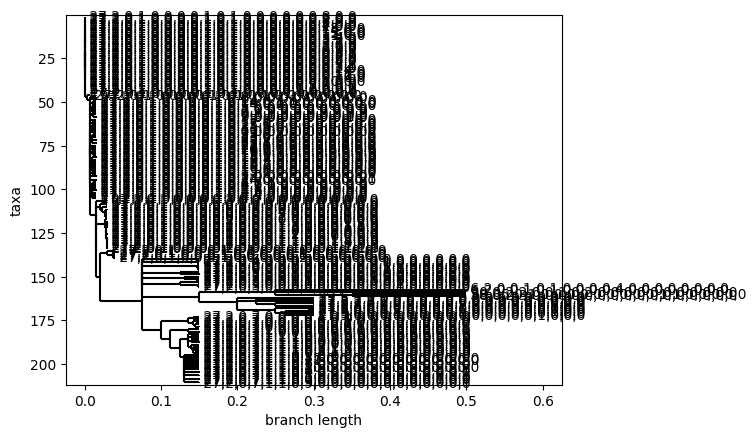

In [15]:
# Use DistanceTreeConstructor to build the NJ tree
constructor = DistanceTreeConstructor()
nj_tree_LINs = constructor.nj(dist_matrix)
nj_tree_LINs.ladderize()

# Define a function to hide labels for internal nodes
def hide_inner_labels(clade):
    return "" if not clade.is_terminal() else clade.name  # Hide labels for internal nodes
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in nj_tree_LINs.get_terminals():
    if clade.name in LIN_Dictionary:
        clade.name = LIN_Dictionary[clade.name]


# Plot the tree with the custom label function
draw(nj_tree_LINs, label_func=hide_inner_labels)

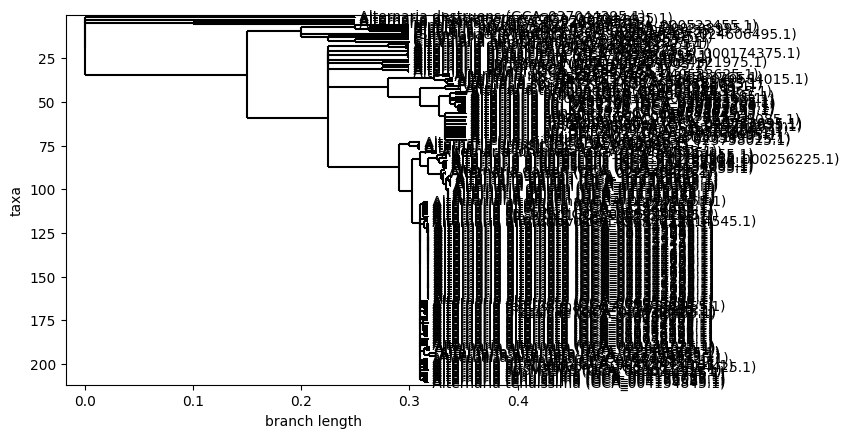

In [16]:
## Compute and display UPGMA LIN tree
## First compute distance matrix, then plot neighbor joining tree

# Load dependencies
from Bio.Phylo.TreeConstruction import DistanceTreeConstructor, _DistanceMatrix
from Bio.Phylo import draw
from scipy.spatial.distance import squareform

# Specify the dataframe containing the LINs for tree building
DfOfInterest = AlternariaLINs_df.copy()

# Convert the "LIN" column from comma-separated strings to lists of integers
DfOfInterest["LIN"] = DfOfInterest["LIN"].apply(lambda x: [int(value) for value in x.split(",")])

# Set some initial parameters
NumEntries = len(DfOfInterest["Accession"])  # Number of LINs under consideration
SimMatrix = np.zeros([NumEntries, NumEntries])  # Initialize a matrix for containing pairwise similarities
LIN_Scheme = np.array([50.0, 70.0, 80.0, 85.0, 90.0, 92.5, 95.0, 96.0, 97.0, 98.0, 98.5, 99.0, 99.25, 99.5, 99.75, 99.9, 99.925, 99.95, 99.975, 99.99, 99.999]) / 100
LINsOfInterest = DfOfInterest["LIN"]  # Define the series containing only the LINs for tree building

# Loop for iterating through all LINs and comparing to all other LINs, determining how many LIN positions from the leftside that each LIN is identical to other LINs
for i in np.arange(NumEntries):
    for ii in np.arange(NumEntries):
        if i == ii:  # Check if LIN is being compared to itself, and if so similarity is 1.0
            SimMatrix[i, ii] = 1
        else:  # If LIN is compared to non-self, continue to counting number of identical positions from the left
            count = 0  # Set counter of identical LIN spaces to zero for each pairwise comparison
            for iii in np.arange(len(LIN_Scheme) - 1):  # iterate through LIN positions until there is a mismatch between the LINs being compared (minus one because I added 50 arbitrarily for those that don't match at the first LIN position)
                if LINsOfInterest[i:i+1].values[0][iii] == LINsOfInterest[ii:ii+1].values[0][iii]:  # Compare successive positions for LINs being compared
                    count += 1
                else:
                    break
            SimMatrix[i, ii] = LIN_Scheme[count]

# Convert similarity matrix to a distance matrix
DistMatrix = 1 - SimMatrix

# Condense distance matrix
DistMatrix = np.tril(DistMatrix).tolist()

# Remove zeros from each sublist
DistMatrix = [
    [value for j, value in enumerate(sublist) if (i == j or value != 0)]
    for i, sublist in enumerate(DistMatrix)
]

# Create a Bio.Phylo distance matrix object
dist_matrix = _DistanceMatrix(list(DfOfInterest["Accession"]), DistMatrix)

# Use DistanceTreeConstructor to build the NJ tree
constructor = DistanceTreeConstructor()
upgma_tree = constructor.upgma(dist_matrix)
upgma_tree.ladderize()


# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree.get_terminals():
    if clade.name in AlternariaDictionary:
        clade.name = AlternariaDictionary[clade.name]


# Plot the tree with the custom label function
draw(upgma_tree, label_func=hide_inner_labels)

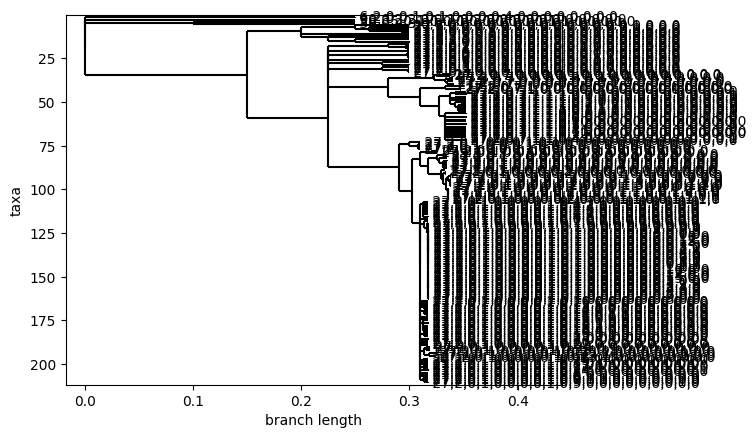

In [17]:
# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_LINs = constructor.upgma(dist_matrix)
upgma_tree_LINs.ladderize()

# Define a function to hide labels for internal nodes
def hide_inner_labels(clade):
    return "" if not clade.is_terminal() else clade.name  # Hide labels for internal nodes
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_LINs.get_terminals():
    if clade.name in LIN_Dictionary:
        clade.name = LIN_Dictionary[clade.name]


# Plot the tree with the custom label function
draw(upgma_tree_LINs, label_func=hide_inner_labels)

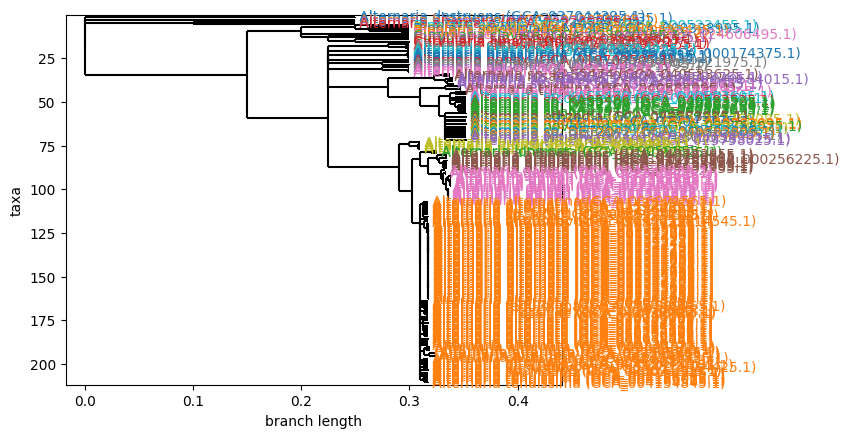

In [18]:
# Use DistanceTreeConstructor to build the NJ tree
constructor = DistanceTreeConstructor()
upgma_tree = constructor.upgma(dist_matrix)
upgma_tree.ladderize()


# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree.get_terminals():
    if clade.name in AlternariaDictionary:
        clade.name = AlternariaDictionary[clade.name]


# Plot the tree with the custom label function
draw(upgma_tree, label_func=hide_inner_labels, label_colors=final_taxon_color_dict)

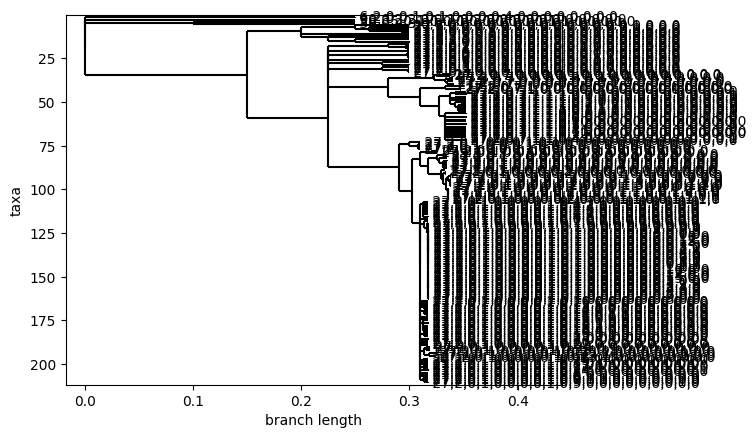

In [19]:
# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_LINs = constructor.upgma(dist_matrix)
upgma_tree_LINs.ladderize()

# Define a function to hide labels for internal nodes
def hide_inner_labels(clade):
    return "" if not clade.is_terminal() else clade.name  # Hide labels for internal nodes
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_LINs.get_terminals():
    if clade.name in LIN_Dictionary:
        clade.name = LIN_Dictionary[clade.name]


# Plot the tree with the custom label function
draw(upgma_tree_LINs, label_func=hide_inner_labels, label_colors=final_color_dict)

In [20]:
os.getcwd()

'/nfs4/BPP/Uehling_Lab/johnsh/FungalLINs/LINsFromKassaye/SecondLIN_Set'

In [21]:
## Convert biopython tree objects to newich format

# Got to directory where files should be saved
os.chdir('/nfs4/BPP/Uehling_Lab/johnsh/FungalLINs/ForGeneTrees/IntermediateFiles/Alternaria_IF')

# Convert the nj_tree to Newick format
newick_nj = StringIO()
Phylo.write(nj_tree, newick_nj, "newick")
Phylo.write(nj_tree, "Alternaria_NJ_LINtree.nwk", "newick")

# Convert the upgma_tree to Newick format
newick_upgma = StringIO()
Phylo.write(upgma_tree, newick_upgma, "newick")
Phylo.write(upgma_tree, "Alternaria_UPGMA_LINtree.nwk", "newick")

# Convert the BUSCOtree to Newick format
#newick_BUSCO = StringIO()
#Phylo.write(BUSCOtree, newick_BUSCO, "newick")
#Phylo.write(BUSCO_tree, "AlternariaBUSCOtree.nwk", "newick")
#print(newick_BUSCO.getvalue())  # This will print the Newick string for BUSCOtree


1

In [22]:
'''
## TO RUN THIS, NEED TO DELETE ONE SET OF QUOTATIONS FROM .NWK FILE for NJ TREE (search for 'sect' to find)

from dendropy.calculate import treecompare
from dendropy import Tree, TaxonNamespace

# Create a shared TaxonNamespace
shared_taxon_namespace = TaxonNamespace()

# Load the trees with the shared TaxonNamespace
newick_nj = Tree.get(path="Alternaria_NJ_LINtree.nwk", schema="newick", taxon_namespace=shared_taxon_namespace)
newick_busco = Tree.get(path="AlternariaBUSCOsTrimmed.faa.treefile", schema="newick", taxon_namespace=shared_taxon_namespace)


                      
weighted_rf = treecompare.weighted_robinson_foulds_distance(newick_nj, newick_busco)
unweighted_rf = treecompare.symmetric_difference(newick_nj, newick_busco)
print(f"Weighted RF Distance: {weighted_rf}")
print(f"Unweighted RF Distance: {unweighted_rf}")
'''

'\n## TO RUN THIS, NEED TO DELETE ONE SET OF QUOTATIONS FROM .NWK FILE for NJ TREE (search for \'sect\' to find)\n\nfrom dendropy.calculate import treecompare\nfrom dendropy import Tree, TaxonNamespace\n\n# Create a shared TaxonNamespace\nshared_taxon_namespace = TaxonNamespace()\n\n# Load the trees with the shared TaxonNamespace\nnewick_nj = Tree.get(path="Alternaria_NJ_LINtree.nwk", schema="newick", taxon_namespace=shared_taxon_namespace)\nnewick_busco = Tree.get(path="AlternariaBUSCOsTrimmed.faa.treefile", schema="newick", taxon_namespace=shared_taxon_namespace)\n\n\n                      \nweighted_rf = treecompare.weighted_robinson_foulds_distance(newick_nj, newick_busco)\nunweighted_rf = treecompare.symmetric_difference(newick_nj, newick_busco)\nprint(f"Weighted RF Distance: {weighted_rf}")\nprint(f"Unweighted RF Distance: {unweighted_rf}")\n'

In [23]:
'''

# Plot the BUSCO tree (first tree)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))  # Create a side-by-side plot

# Draw the BUSCO tree
Phylo.draw(BUSCOtree, axes=ax1, do_show=False)
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90, fontsize=8)
ax1.set_yticklabels(ax1.get_yticklabels(), fontsize=8)


# Plot the dendrogram with horizontal orientation
dendrogram(Z, labels=renamed_labels, orientation='right', ax=ax2)
ax2.set_title("UPGMA Tree", fontsize=12, fontweight='bold')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90, fontsize=8)
ax2.set_yticklabels(ax2.get_yticklabels(), fontsize=8)

# Add lines connecting corresponding leaves between trees
# We need to get the leaf names from both trees and connect them
busco_leaves = [leaf.name for leaf in BUSCOtree.get_terminals()]
upgma_leaves = renamed_labels


# Show the final plot
plt.tight_layout()
plt.show()

'''

'\n\n# Plot the BUSCO tree (first tree)\nfig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))  # Create a side-by-side plot\n\n# Draw the BUSCO tree\nPhylo.draw(BUSCOtree, axes=ax1, do_show=False)\nax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight=\'bold\')\nax1.set_xticklabels(ax1.get_xticklabels(), rotation=90, fontsize=8)\nax1.set_yticklabels(ax1.get_yticklabels(), fontsize=8)\n\n\n# Plot the dendrogram with horizontal orientation\ndendrogram(Z, labels=renamed_labels, orientation=\'right\', ax=ax2)\nax2.set_title("UPGMA Tree", fontsize=12, fontweight=\'bold\')\nax2.set_xticklabels(ax2.get_xticklabels(), rotation=90, fontsize=8)\nax2.set_yticklabels(ax2.get_yticklabels(), fontsize=8)\n\n# Add lines connecting corresponding leaves between trees\n# We need to get the leaf names from both trees and connect them\nbusco_leaves = [leaf.name for leaf in BUSCOtree.get_terminals()]\nupgma_leaves = renamed_labels\n\n\n# Show the final plot\nplt.tight_layout()\nplt.show()\

In [24]:
# Function to hide internal node labels
def hide_inner_labels(clade):
    return "" if not clade.is_terminal() else clade.name

/scratch/ipykernel_2398028/4110207900.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/4110207900.py:19: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


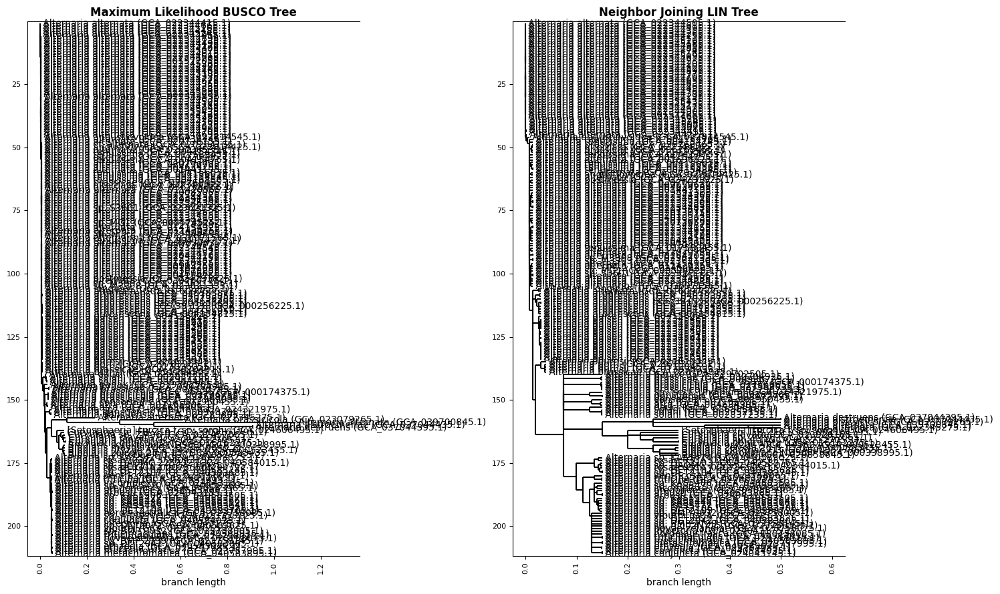

In [25]:
## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

BUSCOtree.ladderize(reverse=False)

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree, label_func=hide_inner_labels, axes=ax1, do_show=False)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/1217805645.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/1217805645.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


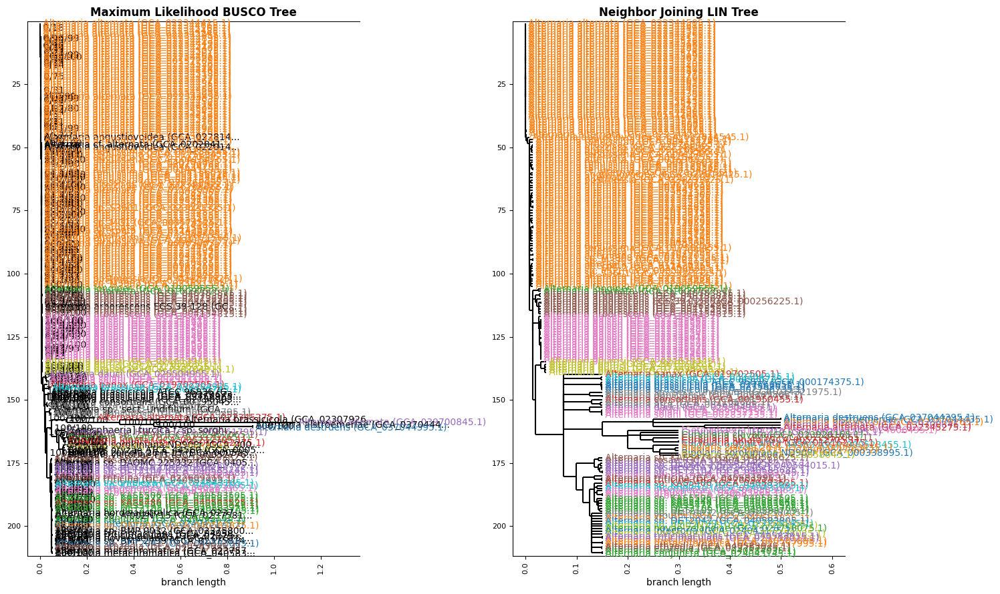

In [26]:
## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/2456907066.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/2456907066.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


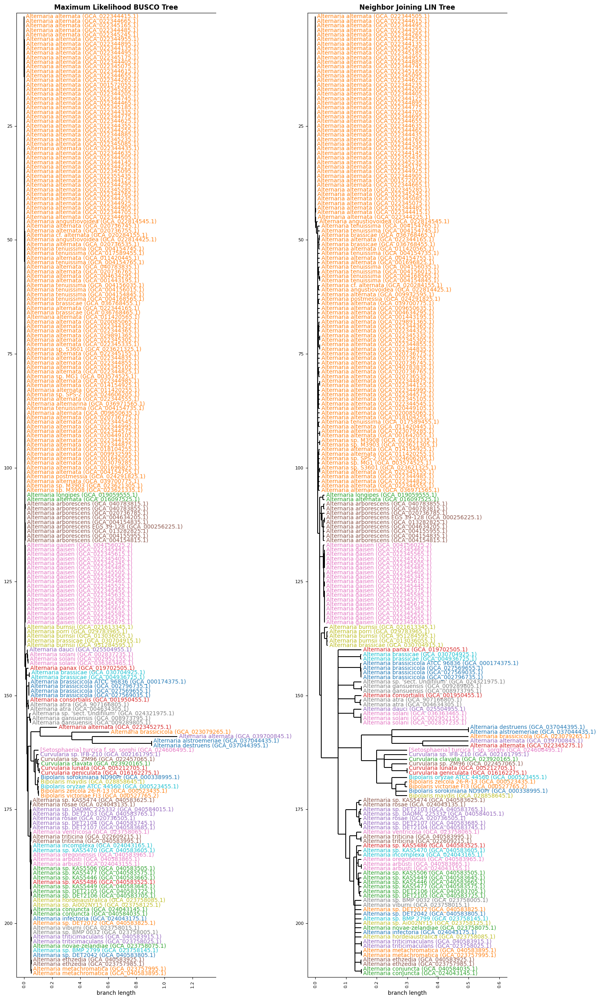

In [27]:

## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

plt.savefig("Alternaria_BUSCOandLIN_NJ_Compare_LIN2.png")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/3794735308.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/3794735308.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


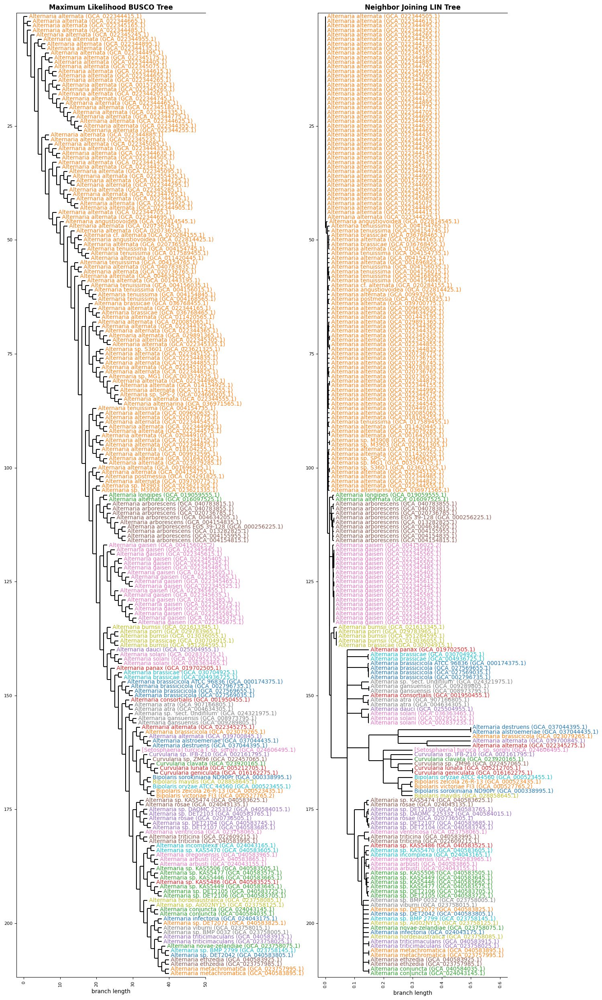

In [28]:
import copy
import math

# Create a copy of the original tree
BUSCOtree_log = copy.deepcopy(BUSCOtree)

# Apply a logarithmic transformation to the branch lengths of the copy
for clade in BUSCOtree_log.find_clades():
    if clade.branch_length is not None:
        clade.branch_length = math.log(clade.branch_length + 1, 0.99)  



## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree_log, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/3698624069.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/3698624069.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


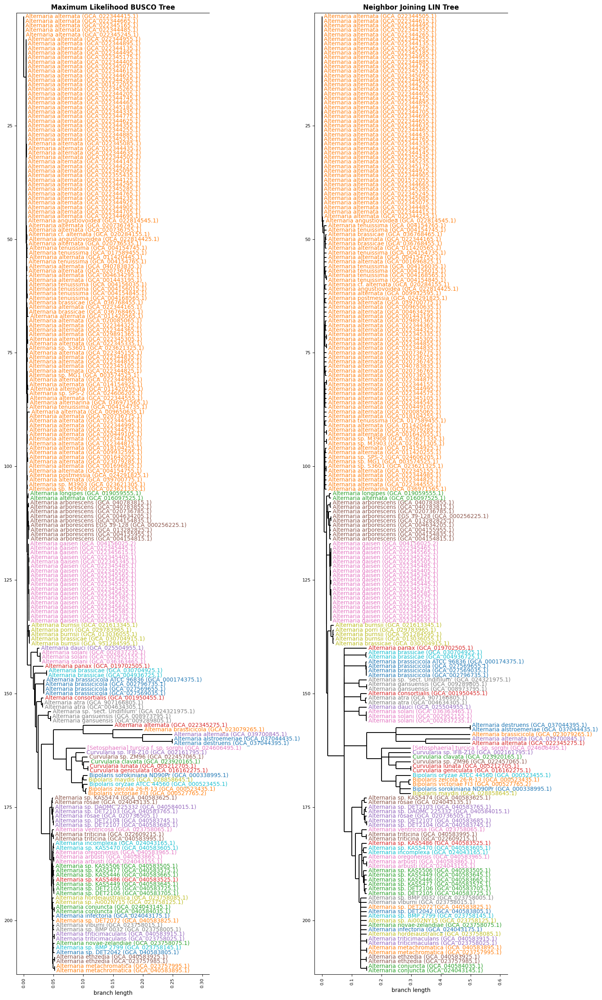

In [29]:
# Create a copy of the original tree
BUSCOtree_cut = copy.deepcopy(BUSCOtree)

# Limit branch lengths to a max value
max_branch_length = 0.05  # Define the maximum branch length

for clade in BUSCOtree_cut.find_clades():
    if clade.branch_length is not None:
        
        # Set the branch length to the transformed value, but limit it to the max value
        clade.branch_length = min(clade.branch_length, max_branch_length)

## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree_cut, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/1507597610.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/1507597610.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


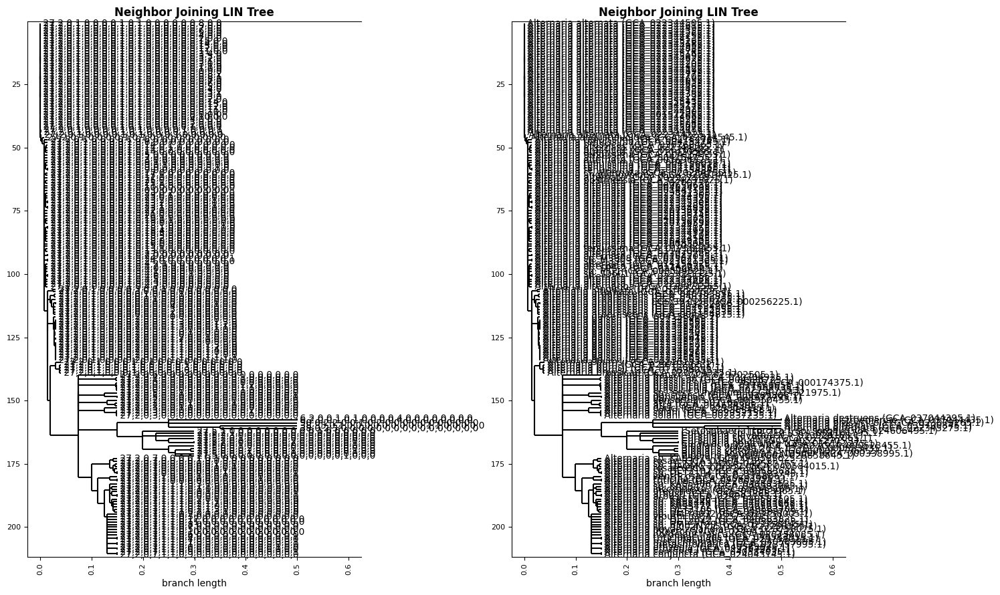

In [30]:
## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Draw the BUSCO tree
ax1.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree_LINs, label_func=hide_inner_labels, axes=ax1, do_show=False)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/1312608611.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/1312608611.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


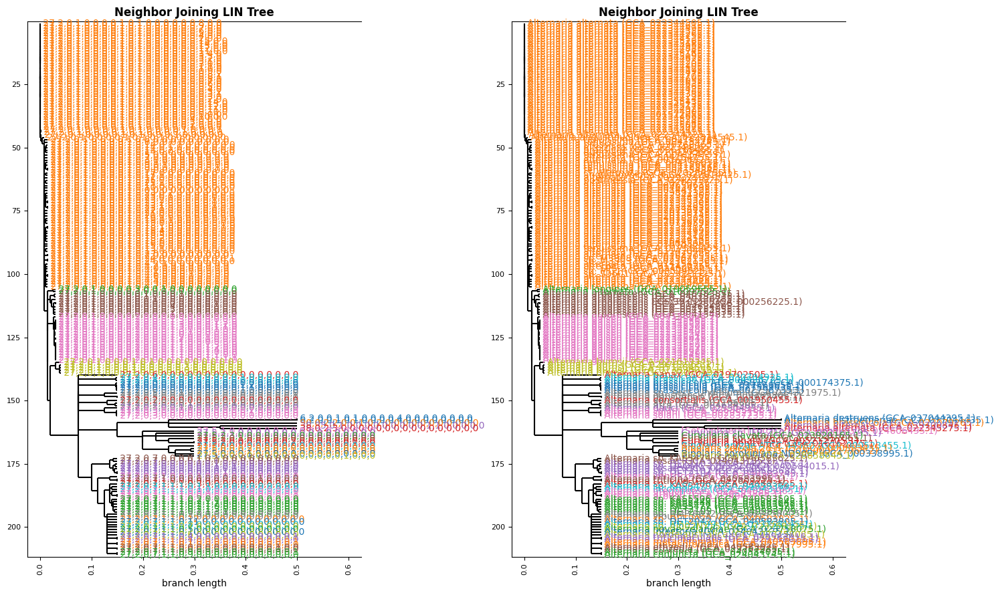

In [31]:
## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Draw the BUSCO tree
ax1.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree_LINs, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/155311052.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/155311052.py:19: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


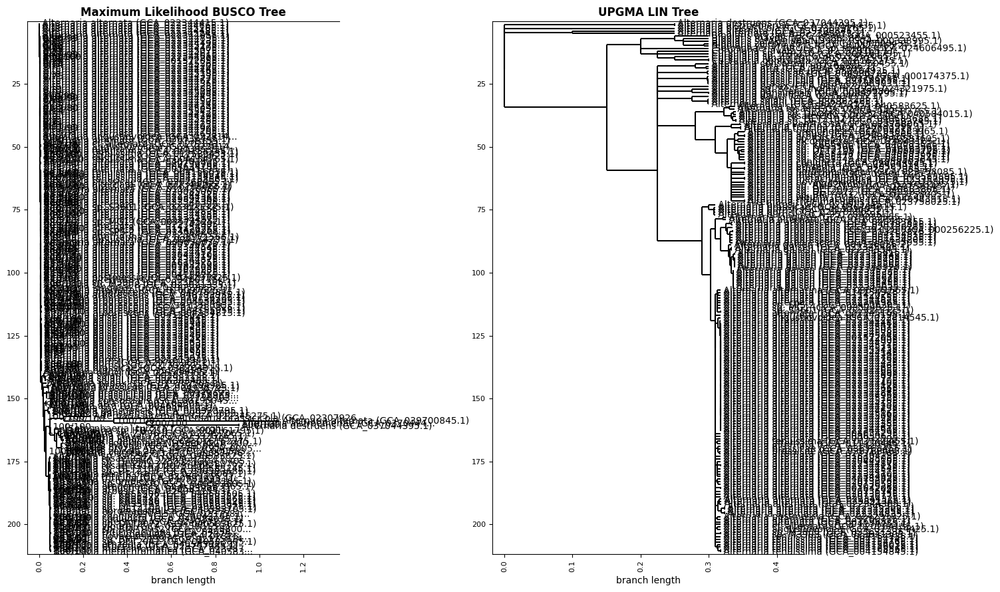

In [32]:
## Create plot for comparing BUSCO and UPGMA-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

BUSCOtree.ladderize(reverse=False)

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree, axes=ax1, do_show=False)

# Draw the UPGMA tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/3132271769.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/3132271769.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


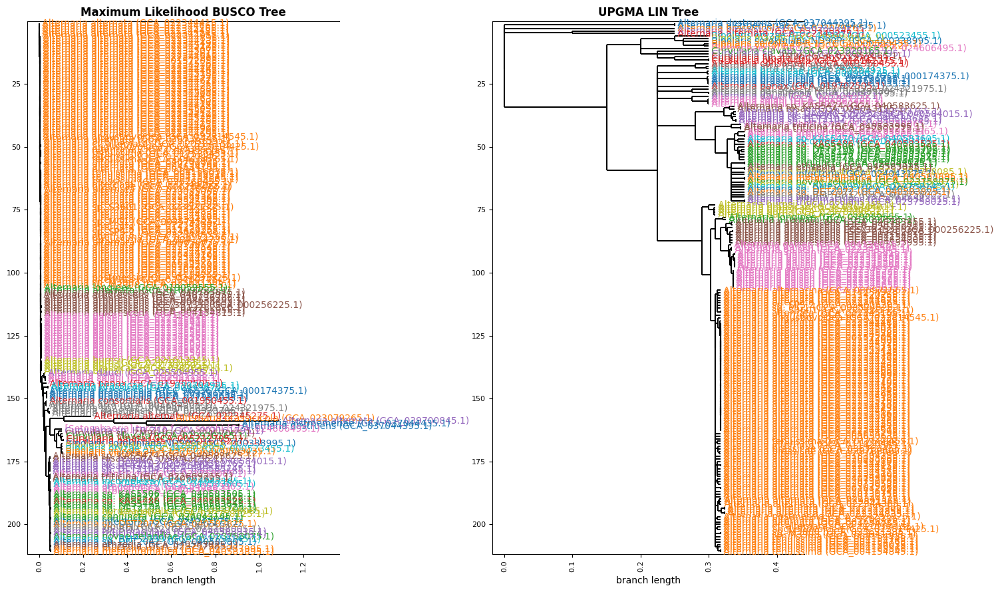

In [33]:
## Create plot for comparing BUSCO and UPGMA-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)

# Draw the UPGMA tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/1725085012.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/1725085012.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


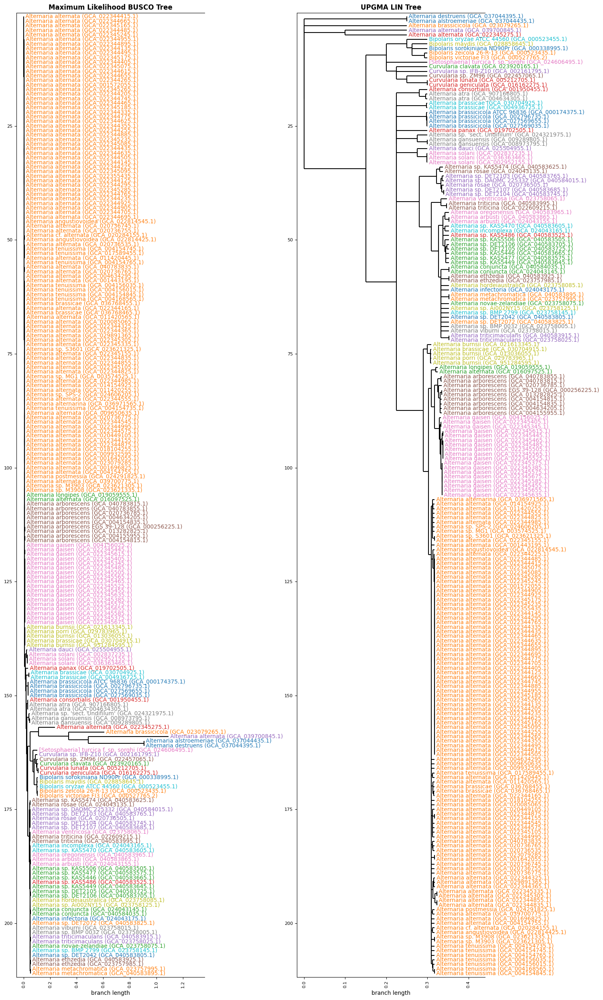

In [34]:

## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(BUSCOtree, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)

# Draw the UPGMA tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")
    
plt.savefig("Alternaria_BUSCOandLIN_UPGMA_Compare_LIN2.png")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/3298749957.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/3298749957.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


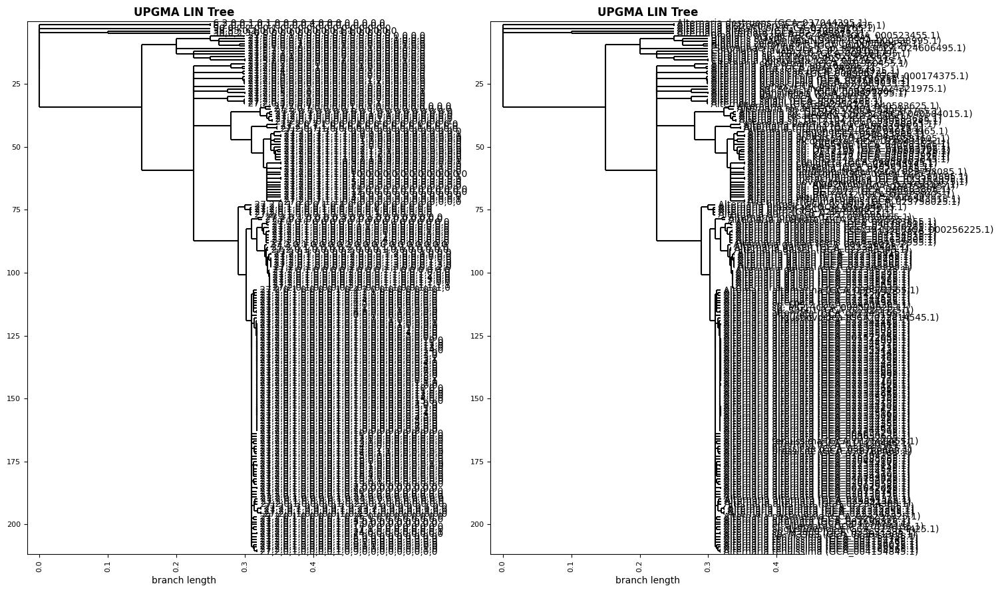

In [35]:
## Create plot for comparing BUSCO and UPGMA-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Draw the BUSCO tree
ax1.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_LINs, label_func=hide_inner_labels, axes=ax1, do_show=False)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/1610219578.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/1610219578.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


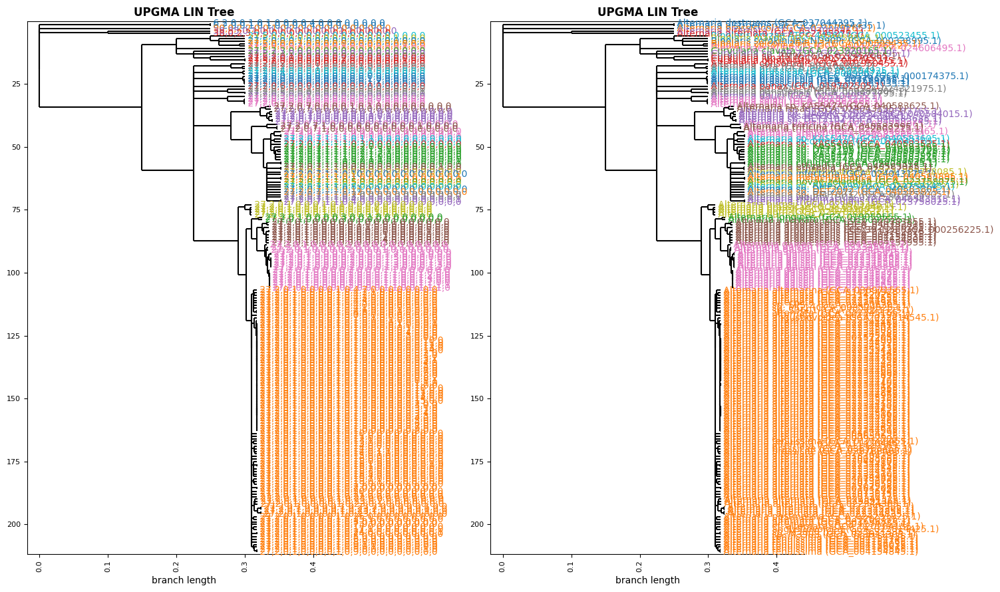

In [36]:
## Create plot for comparing BUSCO and UPGMA-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Draw the BUSCO tree
ax1.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_LINs, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

In [37]:
os.chdir('/nfs4/BPP/Uehling_Lab/johnsh/ncbi_dataset/data')


import json

# Load JSONL file
data = []
with open('assembly_data_report.jsonl', 'r') as file:
    for line in file:
        data.append(json.loads(line))


# Function to pull required info
def flatten_record(record):
    flattened = {
        # Top-level fields
        "accession": record.get("accession"),
        #"currentAccession": record.get("currentAccession"),
        "organismName": record.get("organism", {}).get("organismName"),
        #"taxId": record.get("organism", {}).get("taxId"),
        #"sourceDatabase": record.get("sourceDatabase"),
        
        # From assemblyInfo
        #"assemblyLevel": record.get("assemblyInfo", {}).get("assemblyLevel"),
        "assemblyMethod": record.get("assemblyInfo", {}).get("assemblyMethod"),
        #"assemblyName": record.get("assemblyInfo", {}).get("assemblyName"),
        #"assemblyStatus": record.get("assemblyInfo", {}).get("assemblyStatus"),
        "sequencingTech": record.get("assemblyInfo", {}).get("sequencingTech"),
        "submitter": record.get("assemblyInfo", {}).get("submitter"),
        "bioprojectAccession": record.get("assemblyInfo", {}).get("bioprojectAccession"),
        
        # From biosample
        "strain": record.get("assemblyInfo", {}).get("biosample", {}).get("strain"),
        "host": record.get("assemblyInfo", {}).get("biosample", {}).get("host"),
        "isolationSource": record.get("assemblyInfo", {}).get("biosample", {}).get("isolationSource"),
        "geoLocName": record.get("assemblyInfo", {}).get("biosample", {}).get("geoLocName"),
        "latLon": record.get("assemblyInfo", {}).get("biosample", {}).get("latLon"),
        
        # From assemblyStats
        "contigL50": record.get("assemblyStats", {}).get("contigL50"),
        "contigN50": record.get("assemblyStats", {}).get("contigN50"),
        "numberOfContigs": record.get("assemblyStats", {}).get("numberOfContigs"),
        "genomeCoverage": record.get("assemblyStats", {}).get("genomeCoverage"),
        "gcPercent": record.get("assemblyStats", {}).get("gcPercent"),
        "totalSequenceLength": record.get("assemblyStats", {}).get("totalSequenceLength"),
    }
    return flattened
    

# Apply the flattening function to all records
flattened_data = [flatten_record(record) for record in data]

# Convert to DataFrame
df = pd.DataFrame(flattened_data)

# Filter the DataFrame to retain rows with 'accession' in the dictionary keys
filtered_df = df[df['accession'].isin(AlternariaDictionary.keys())]

In [ ]:
# Create a dictionary 
StrainDictionary = dict(zip(filtered_df['accession'], filtered_df['strain']))

# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_Strain = constructor.upgma(dist_matrix)
upgma_tree_Strain.ladderize(reverse=False)
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_Strain.get_terminals():
    if clade.name in StrainDictionary:
        clade.name = StrainDictionary[clade.name]


## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Strain Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_Strain, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_2398028/532903652.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_2398028/532903652.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


/scratch/ipykernel_528331/4209239382.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/4209239382.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


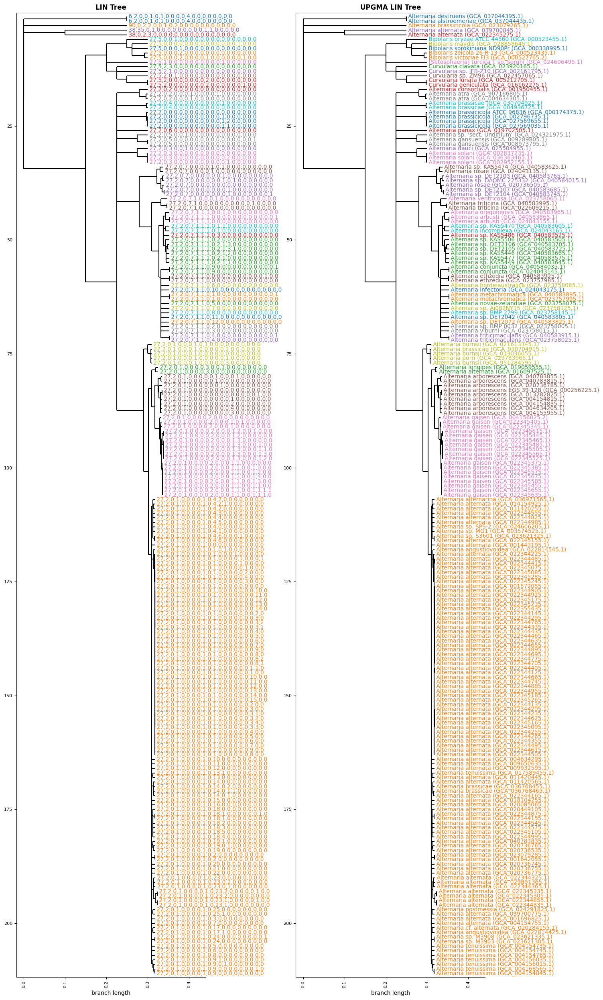

In [47]:
## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_LINs, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/1224403775.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/1224403775.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


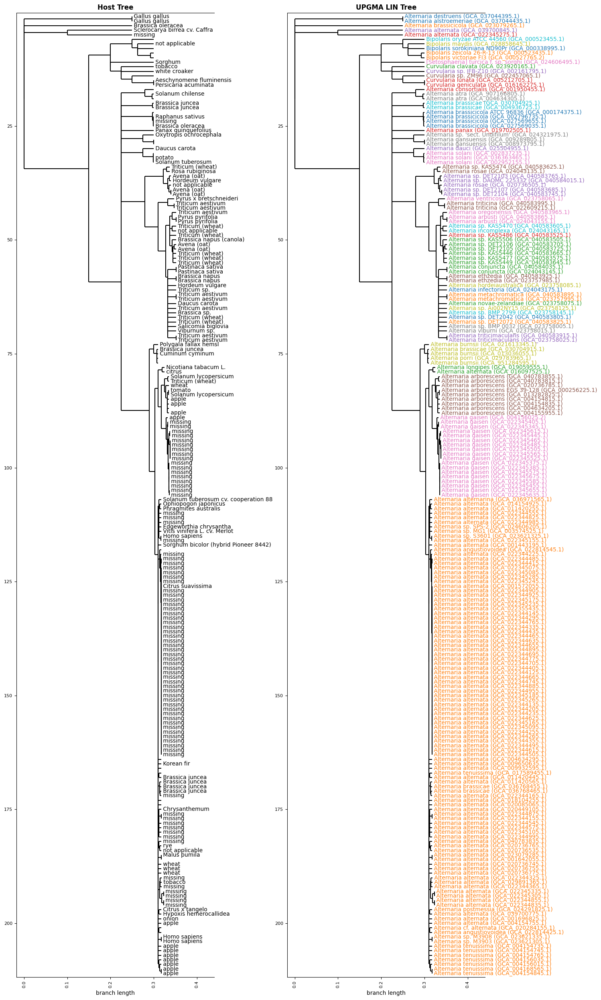

In [48]:
# Create a dictionary 
HostDictionary = dict(zip(filtered_df['accession'], filtered_df['host']))

# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_Host = constructor.upgma(dist_matrix)
upgma_tree_Host.ladderize()
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_Host.get_terminals():
    if clade.name in HostDictionary:
        clade.name = HostDictionary[clade.name]


## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Host Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_Host, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/2328886183.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/2328886183.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


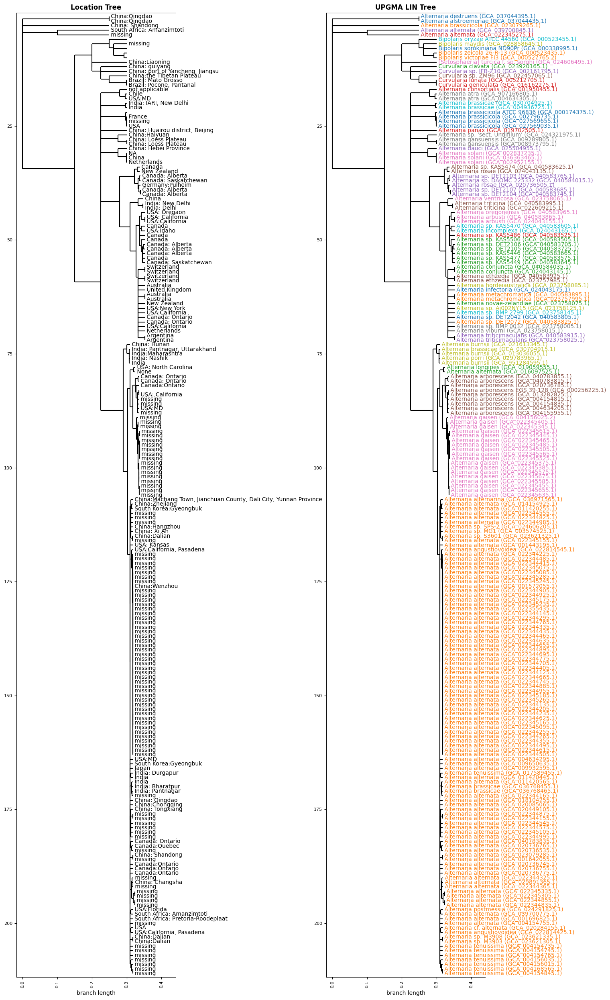

In [49]:
# Create a dictionary 
LocationDictionary = dict(zip(filtered_df['accession'], filtered_df['geoLocName']))

# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_Location = constructor.upgma(dist_matrix)
upgma_tree_Location.ladderize()
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_Location.get_terminals():
    if clade.name in LocationDictionary:
        clade.name = LocationDictionary[clade.name]


## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Location Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_Location, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/2490713605.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/2490713605.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


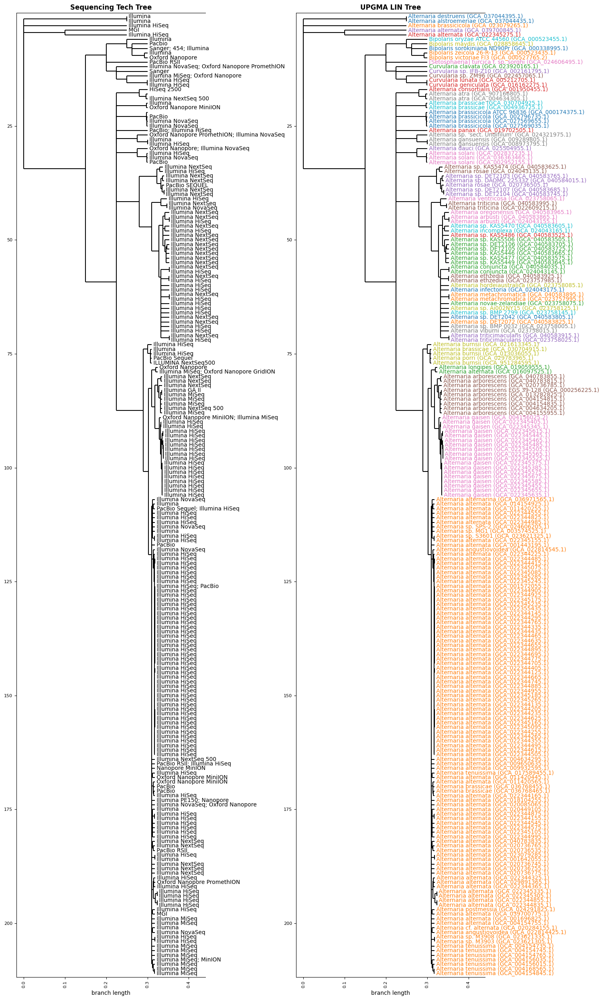

In [50]:
# Create a dictionary
SeqTechDictionary = dict(zip(filtered_df['accession'], filtered_df['sequencingTech']))

# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_SeqTech = constructor.upgma(dist_matrix)
upgma_tree_SeqTech.ladderize()
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_SeqTech.get_terminals():
    if clade.name in SeqTechDictionary:
        clade.name = SeqTechDictionary[clade.name]


## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Sequencing Tech Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_SeqTech, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/3014179113.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/3014179113.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


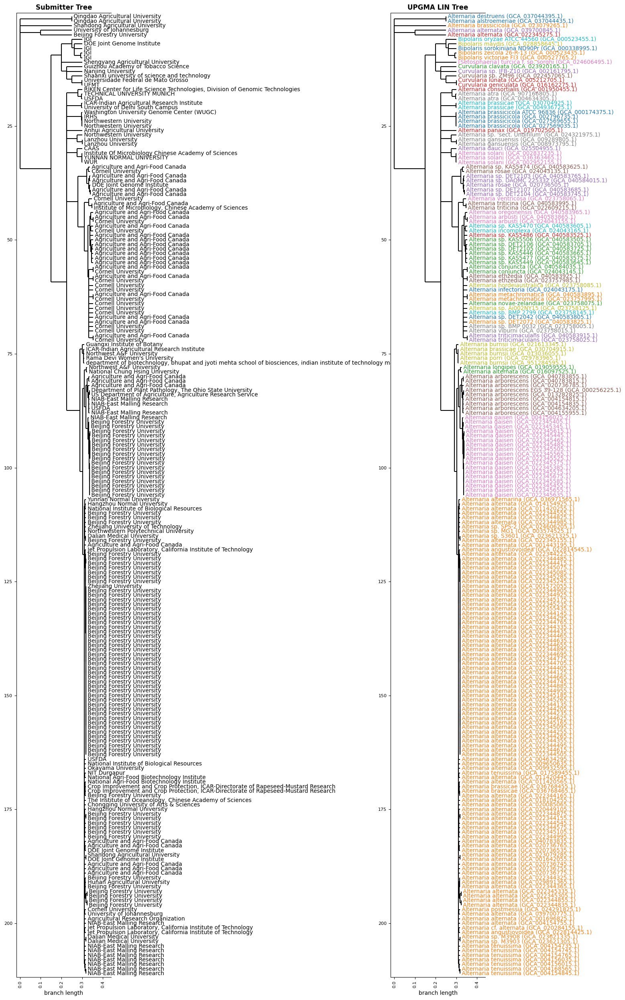

In [51]:
# Create a dictionary 
SubmitterDictionary = dict(zip(filtered_df['accession'], filtered_df['submitter']))

# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_Submitter = constructor.upgma(dist_matrix)
upgma_tree_Submitter.ladderize()
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_Submitter.get_terminals():
    if clade.name in SubmitterDictionary:
        clade.name = SubmitterDictionary[clade.name]


## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Submitter Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_Submitter, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/98244523.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/98244523.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


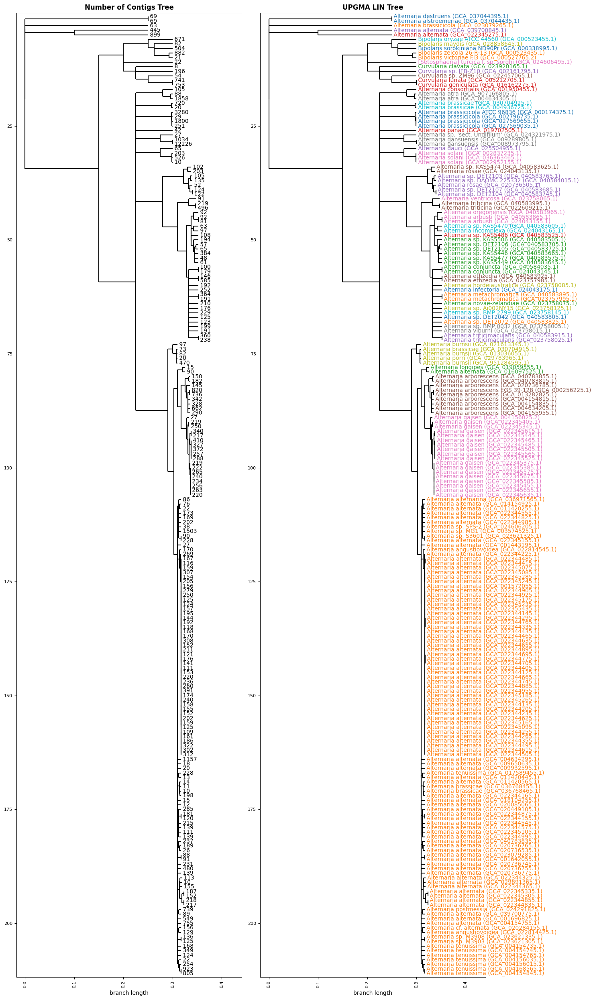

In [52]:
# Create a dictionary 
NumContigsDictionary = dict(zip(filtered_df['accession'], filtered_df['numberOfContigs']))

# Use DistanceTreeConstructor to build the UPGMA tree
constructor = DistanceTreeConstructor()
upgma_tree_NumContigs = constructor.upgma(dist_matrix)
upgma_tree_NumContigs.ladderize()
    
# Iterate through the leaves of the tree and rename them based on the dictionary
for clade in upgma_tree_NumContigs.get_terminals():
    if clade.name in NumContigsDictionary:
        clade.name = NumContigsDictionary[clade.name]


## Create plot for comparing UPGMA-LIN tree info
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Number of Contigs Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree_NumContigs, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("UPGMA LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(upgma_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")

# Show the plot
plt.tight_layout()
plt.show()

## Now filter for specific taxa to show only clades of interest (as they are too hard to see in overall tree figure)

In [53]:
def filter_tree4(tree, substrings):
    """
    Prune the tree to keep only paths leading to leaves whose names contain any of the provided substrings.

    Parameters:
    - tree: The tree to filter (Phylo.BaseTree.Tree).
    - substrings: A list of substrings to match against leaf names.

    Returns:
    - pruned_tree: A new tree containing only paths to matching leaves.
    """
    # Copy the tree to avoid modifying the original
    tree = copy.deepcopy(tree)

    # Find all leaf nodes
    all_leaves = {leaf: False for leaf in tree.get_terminals()}

    # Mark leaves to keep
    for leaf in all_leaves:
        if any(substring in leaf.name for substring in substrings):
            all_leaves[leaf] = True

    def prune_clade(clade):
        """
        Recursively prune clades to keep only those leading to matching leaves.
        """
        if clade.is_terminal():
            # Keep the terminal node only if it's marked
            return all_leaves.get(clade, False)
        else:
            # Recursively prune child clades
            clade.clades = [child for child in clade.clades if prune_clade(child)]
            # Keep this clade if it has any remaining children
            return bool(clade.clades)

    # Prune the root
    if not prune_clade(tree.root):
        return None  # Return None if no matching leaves remain

    return tree

In [54]:
Taxa = []
for clade in BUSCOtree.find_clades():
    Taxa.append(clade.name)


def clean_taxa_list(taxa_list):
    """
    Cleans a list of taxa by removing branch strengths and None values.
    
    Parameters:
        taxa_list (list): List of taxa with potential branch strengths and None values.
        
    Returns:
        list: Cleaned list with branch strengths and None values removed.
    """
    import re
    # Regular expression to match branch strengths (e.g., "98.6/100")
    branch_strength_pattern = re.compile(r'^\d+(\.\d+)?/\d+$')
    
    # Filter the list to remove branch strengths and None values
    cleaned_list = [
        item for item in taxa_list 
        if item is not None and not branch_strength_pattern.match(item)
    ]
    
    return cleaned_list


# Remove "None" and branch strengths, leaving just taxa names and accessions
Taxa = clean_taxa_list(Taxa)

In [55]:
for i in np.arange(len(Taxa)):
    print(i, Taxa[i])

0 Alternaria alternata (GCA_022344415.1)
1 Alternaria alternata (GCA_022344665.1)
2 Alternaria alternata (GCA_022345165.1)
3 Alternaria alternata (GCA_022344485.1)
4 Alternaria alternata (GCA_022345245.1)
5 Alternaria alternata (GCA_022344955.1)
6 Alternaria alternata (GCA_022344895.1)
7 Alternaria alternata (GCA_022344135.1)
8 Alternaria alternata (GCA_022344495.1)
9 Alternaria alternata (GCA_022345175.1)
10 Alternaria alternata (GCA_022344405.1)
11 Alternaria alternata (GCA_022345075.1)
12 Alternaria alternata (GCA_022344615.1)
13 Alternaria alternata (GCA_022344655.1)
14 Alternaria alternata (GCA_022344265.1)
15 Alternaria alternata (GCA_001572055.1)
16 Alternaria alternata (GCA_022345265.1)
17 Alternaria alternata (GCA_022344205.1)
18 Alternaria alternata (GCA_022344745.1)
19 Alternaria alternata (GCA_022344465.1)
20 Alternaria alternata (GCA_022345185.1)
21 Alternaria alternata (GCA_022344335.1)
22 Alternaria alternata (GCA_022344775.1)
23 Alternaria alternata (GCA_022344625.1)
24

/scratch/ipykernel_528331/3820921554.py:52: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/3820921554.py:53: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


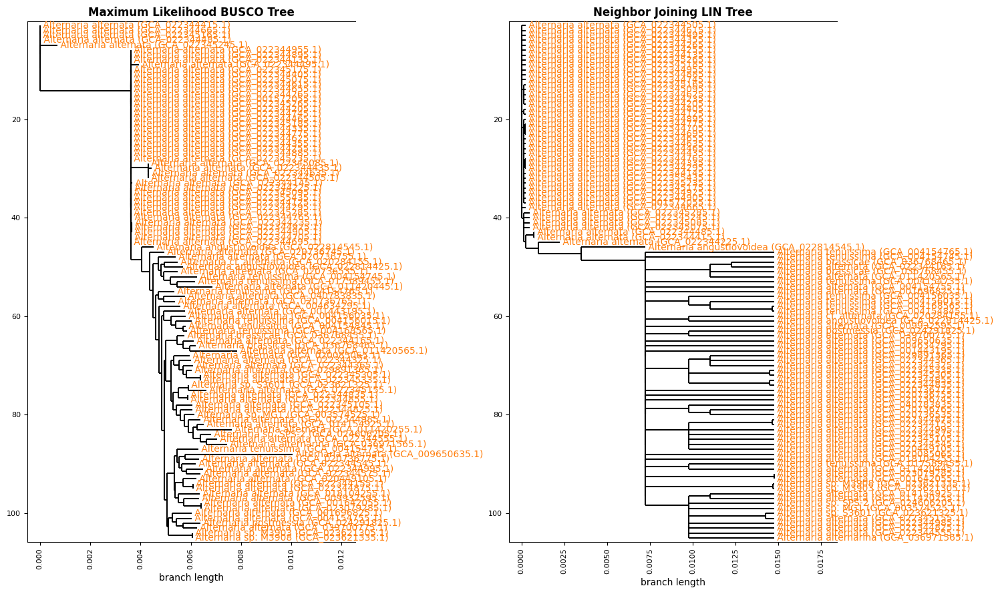

In [56]:
import copy

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Make a copy of the tree to filter
BUSCOtree_filtered = copy.deepcopy(BUSCOtree)

# Get the set of taxa to retain
taxa_to_keep = set(Taxa[:105])

# Recursive function to prune the tree
def prune_tree(tree, taxa_to_keep):
    """
    Recursively prune the tree, keeping only the taxa in `taxa_to_keep`.
    Removes empty clades and excess branches.
    """
    # Iterate through clades in reverse to avoid modifying the list while iterating
    for clade in tree.clades[:]:
        if clade.is_terminal():
            # Remove terminal clades not in taxa_to_keep
            if clade.name not in taxa_to_keep:
                tree.clades.remove(clade)
        else:
            # Recursively prune non-terminal clades
            prune_tree(clade, taxa_to_keep)
            # Remove empty clades
            if not clade.clades:
                tree.clades.remove(clade)
                
# Apply the pruning function to the BUSCO tree
prune_tree(BUSCOtree_filtered.root, taxa_to_keep)


# Draw the BUSCO tree
#BUSCOtree_filtered.ladderize(reverse = False)
Phylo.draw(BUSCOtree_filtered, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
# Set the x-axis limits for ax1
#ax1.set_xlim(left=0.245, right=0.27)  # Adjust these values as per your data



# Draw the NJ tree on ax2
Phylo.draw(filter_tree4(nj_tree, Taxa[:105]), label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
#ax2.set_xlim(left=0.28, right=0.35)  # Adjust these values as per your data


# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")


# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/563234622.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/563234622.py:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


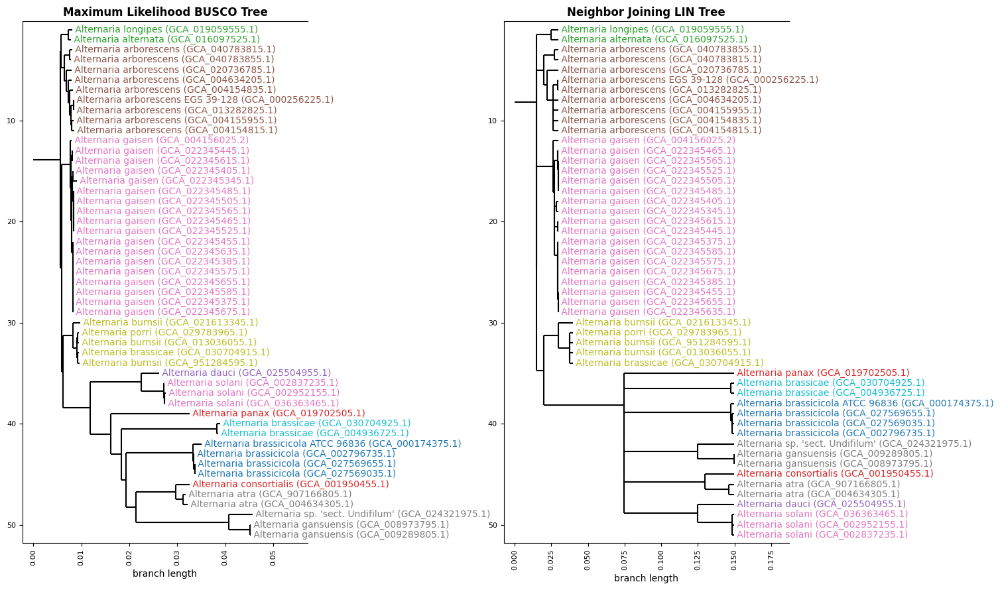

In [57]:
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Make a copy of the tree to filter
BUSCOtree_filtered = copy.deepcopy(BUSCOtree)

# Get the set of taxa to retain
taxa_to_keep = set(Taxa[105:156])

                
# Apply the pruning function to the BUSCO tree
prune_tree(BUSCOtree_filtered.root, taxa_to_keep)


# Draw the BUSCO tree
BUSCOtree_filtered.ladderize(reverse = False)
Phylo.draw(BUSCOtree_filtered, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
# Set the x-axis limits for ax1
#ax1.set_xlim(left=0.245, right=0.27)  # Adjust these values as per your data



# Draw the NJ tree on ax2
Phylo.draw(filter_tree4(nj_tree, Taxa[105:156]), label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")


# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/4232573234.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/4232573234.py:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


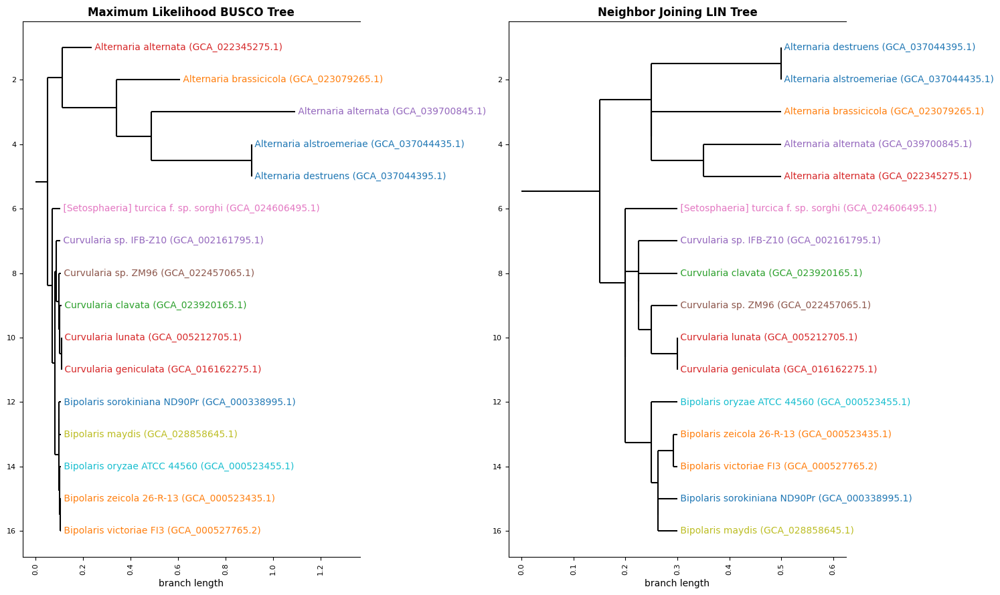

In [58]:
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Make a copy of the tree to filter
BUSCOtree_filtered = copy.deepcopy(BUSCOtree)

# Get the set of taxa to retain
taxa_to_keep = set(Taxa[156:172])

                
# Apply the pruning function to the BUSCO tree
prune_tree(BUSCOtree_filtered.root, taxa_to_keep)


# Draw the BUSCO tree
BUSCOtree_filtered.ladderize(reverse = False)
Phylo.draw(BUSCOtree_filtered, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
# Set the x-axis limits for ax1
#ax1.set_xlim(left=0.09, right=0.11)  # Adjust these values as per your data



# Draw the NJ tree on ax2
Phylo.draw(filter_tree4(nj_tree, Taxa[156:172]), label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")


# Show the plot
plt.tight_layout()
plt.show()

/scratch/ipykernel_528331/143411005.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/scratch/ipykernel_528331/143411005.py:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


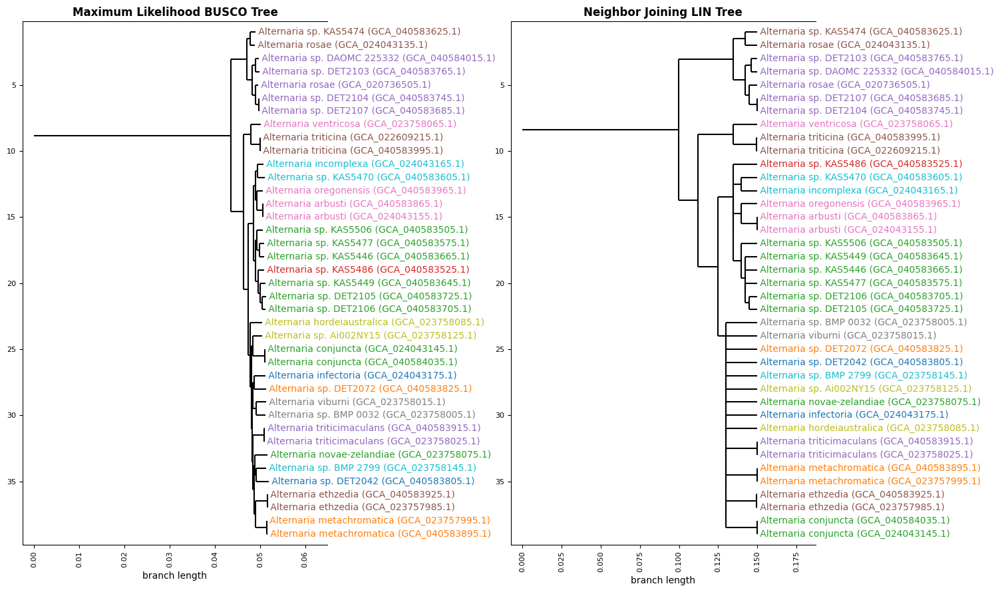

In [59]:
# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9))

# Make a copy of the tree to filter
BUSCOtree_filtered = copy.deepcopy(BUSCOtree)

# Get the set of taxa to retain
taxa_to_keep = set(Taxa[172:])

                
# Apply the pruning function to the BUSCO tree
prune_tree(BUSCOtree_filtered.root, taxa_to_keep)


# Draw the BUSCO tree
BUSCOtree_filtered.ladderize(reverse = False)
Phylo.draw(BUSCOtree_filtered, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=final_taxon_color_dict)
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
# Set the x-axis limits for ax1
#ax1.set_xlim(left=0.09, right=0.11)  # Adjust these values as per your data



# Draw the NJ tree on ax2
Phylo.draw(filter_tree4(nj_tree, Taxa[172:]), label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")


# Show the plot
plt.tight_layout()
plt.show()

## Try to get contraspecific minimum ANI, and minimum ANI between sister species

/tmp/ipykernel_2650979/2014139375.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
/tmp/ipykernel_2650979/2014139375.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)


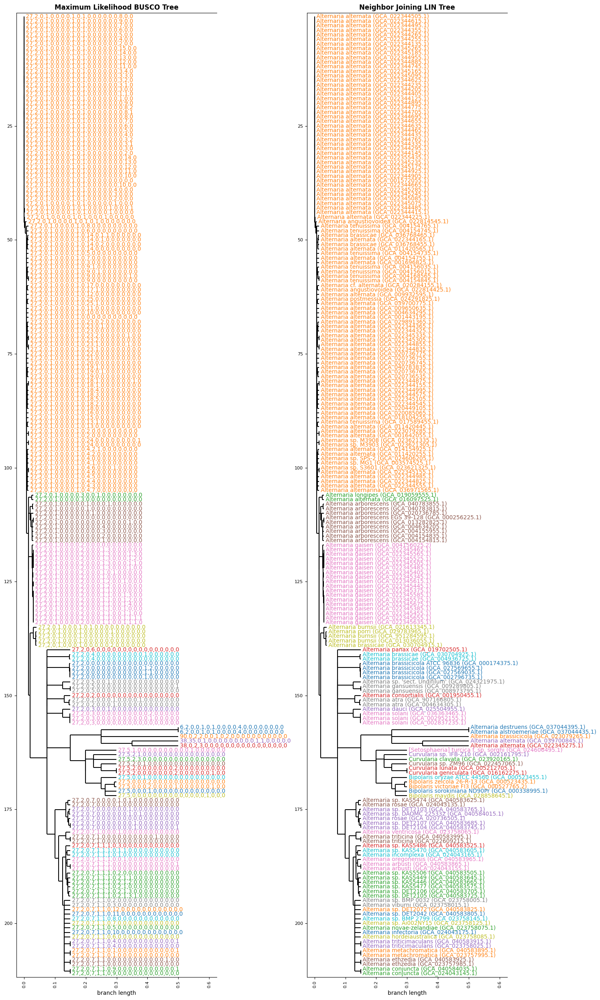

In [40]:

## Create plot for comparing BUSCO and NJ-LIN tree

# Create the side-by-side plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 25))

# Draw the BUSCO tree
ax1.set_title("Maximum Likelihood BUSCO Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree_LINs, label_func=hide_inner_labels, axes=ax1, do_show=False, label_colors=LIN_color_dict)

# Draw the NJ tree on ax2
ax2.set_title("Neighbor Joining LIN Tree", fontsize=12, fontweight='bold')
Phylo.draw(nj_tree, label_func=hide_inner_labels, axes=ax2, do_show=False, label_colors=final_taxon_color_dict)

# Adjust tick labels and rotation
for ax in [ax1, ax2]:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel("")


# Show the plot
plt.tight_layout()
plt.show()

In [37]:
from Bio import Phylo
from collections import defaultdict
from itertools import combinations

# Your LINs definitions
LINs = [75.0, 80.0, 85.0, 90.0, 92.5, 95.0, 96.0, 97.0, 98.0, 98.5, 
        99.0, 99.25, 99.5, 99.75, 99.9, 99.925, 99.95, 99.975, 99.99, 99.999]

def get_species_name(label):
    """Extract species name from label (first two words)"""
    parts = label.split()
    return ' '.join(parts[:2])

def compare_lin(lin1, lin2):
    """Compare two LINs and return the number of shared positions"""
    lin1_parts = lin1.split(',')
    lin2_parts = lin2.split(',')
    shared = 0
    for p1, p2 in zip(lin1_parts, lin2_parts):
        if p1 == p2:
            shared += 1
        else:
            break
    return shared

# Get all terminal nodes (leaves) from both trees
lin_leaves = [leaf for leaf in nj_tree_LINs.get_terminals()]
species_leaves = [leaf for leaf in nj_tree.get_terminals()]

# Create a mapping from species name to LIN strings
species_to_lins = defaultdict(list)
for species_leaf, lin_leaf in zip(species_leaves, lin_leaves):
    species_name = get_species_name(species_leaf.name)
    species_to_lins[species_name].append(lin_leaf.name)

# 1. Calculate minimum shared positions and corresponding ANI for each species (only for species with >1 sample)
species_ani = {}
for species, lins in species_to_lins.items():
    if len(lins) <= 1:
        continue  # Skip species with only one sample
    
    min_shared = 20  # Start with maximum possible
    # Compare all pairs of LINs for this species
    for lin1, lin2 in combinations(lins, 2):
        shared = compare_lin(lin1, lin2)
        if shared < min_shared:
            min_shared = shared
    
    # Get the corresponding ANI percentage
    ani = LINs[min_shared-1] if min_shared > 0 else 0
    species_ani[species] = (min_shared, ani)

# Print results
print("Minimum similarity within species (only species with multiple samples):")
for species, (shared, ani) in sorted(species_ani.items()):
    print(f"{species}: shares first {shared} LIN positions, ANI ≥ {ani}%")

Minimum similarity within species (only species with multiple samples):
Alternaria alternata: shares first 0 LIN positions, ANI ≥ 0%
Alternaria angustiovoidea: shares first 10 LIN positions, ANI ≥ 98.5%
Alternaria arborescens: shares first 9 LIN positions, ANI ≥ 98.0%
Alternaria arbusti: shares first 19 LIN positions, ANI ≥ 99.99%
Alternaria atra: shares first 12 LIN positions, ANI ≥ 99.25%
Alternaria brassicae: shares first 3 LIN positions, ANI ≥ 85.0%
Alternaria brassicicola: shares first 0 LIN positions, ANI ≥ 0%
Alternaria burnsii: shares first 9 LIN positions, ANI ≥ 98.0%
Alternaria conjuncta: shares first 19 LIN positions, ANI ≥ 99.99%
Alternaria ethzedia: shares first 17 LIN positions, ANI ≥ 99.95%
Alternaria gaisen: shares first 12 LIN positions, ANI ≥ 99.25%
Alternaria gansuensis: shares first 19 LIN positions, ANI ≥ 99.99%
Alternaria metachromatica: shares first 19 LIN positions, ANI ≥ 99.99%
Alternaria rosae: shares first 8 LIN positions, ANI ≥ 97.0%
Alternaria solani: share